# Gọi thư viện cần thiết 

In [1]:
import numpy as np
from PIL import Image, ImageFont, ImageDraw
from PIL.ImageChops import add, subtract, multiply, difference, screen
import PIL.ImageStat as stat
from skimage.io import imread, imsave, imshow, show, imread_collection, imshow_collection
from skimage import color, exposure, img_as_float, data
from skimage.transform import SimilarityTransform, warp, swirl
from skimage.util import invert, random_noise, montage
import matplotlib.image as mpimg
import matplotlib.pylab as plt
from scipy.ndimage import affine_transform, zoom
from scipy import misc

# Erosion

Ảnh ban đầu 

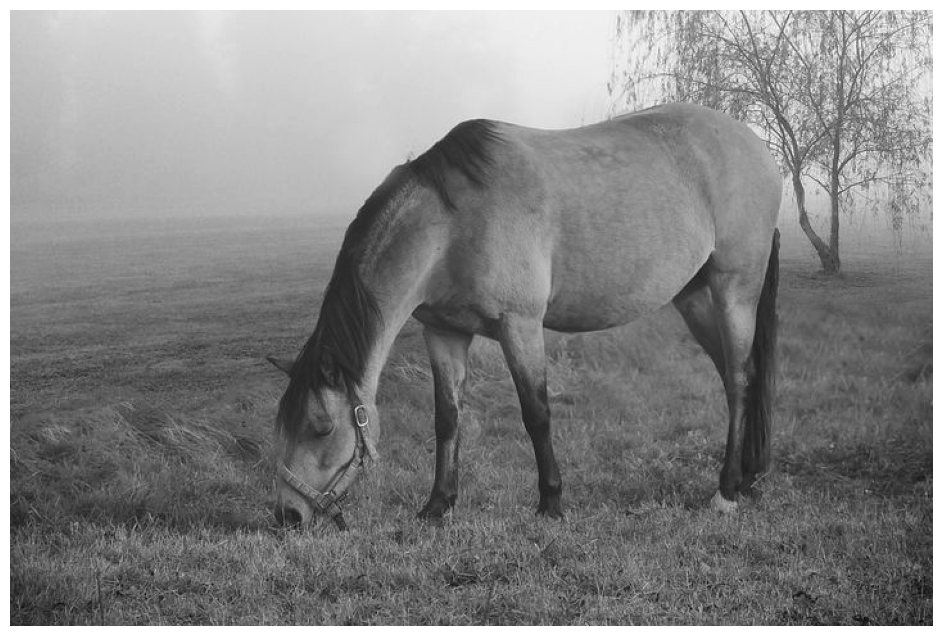

In [2]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến bức ảnh đầu tiên
img_path = "/kaggle/input/data-btl-xla/images/horses.jpg"

# Mở ảnh và chuyển đổi thành ảnh grayscale
img = Image.open(img_path).convert('L')  # Chuyển thành ảnh xám

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(12, 8))

# Hiển thị bức ảnh xám
plt.imshow(img, cmap='gray')  # Đặt `cmap='gray'` để hiển thị ảnh xám

# Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
plt.axis('off')

# Hiển thị ảnh
plt.show()

Ảnh sau xử lý 

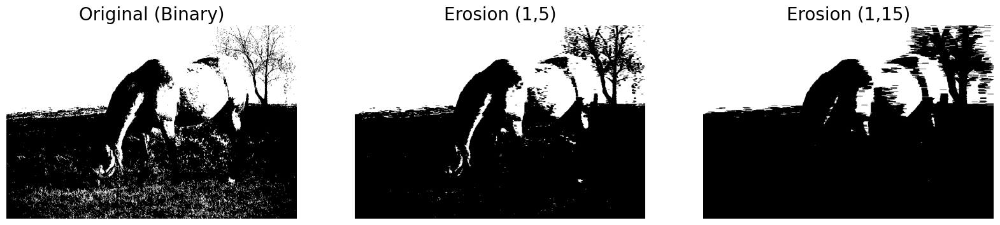

In [3]:
from PIL import Image
import matplotlib.pyplot as plt
from skimage.morphology import binary_erosion, rectangle
import numpy as np

# Đường dẫn đến ảnh
img_path = "/kaggle/input/data-btl-xla/images/horses.jpg"

# Mở ảnh và chuyển thành grayscale, sau đó tạo ảnh nhị phân với ngưỡng 0.5
img = Image.open(img_path).convert('L')
img_np = np.array(img) / 255.0  # Chuyển ảnh thành mảng numpy với giá trị từ 0 đến 1
binary_img = np.where(img_np > 0.5, 1, 0)  # Tạo ảnh nhị phân với ngưỡng 0.5

# Áp dụng phép xói mòn với hai kích thước khác nhau của kernel hình chữ nhật
eroded_img_1 = binary_erosion(binary_img, rectangle(1, 5))
eroded_img_2 = binary_erosion(binary_img, rectangle(1, 15))

# Định nghĩa hàm hiển thị ảnh
def plot_image(image, title=''):
    plt.title(title, size=20)
    plt.imshow(image, cmap='gray')
    plt.axis('off')

# Hiển thị ảnh gốc và ảnh sau khi áp dụng phép xói mòn
plt.figure(figsize=(20, 10))
plt.subplot(1, 3, 1)
plot_image(binary_img, 'Original (Binary)')
plt.subplot(1, 3, 2)
plot_image(eroded_img_1, 'Erosion (1,5)')
plt.subplot(1, 3, 3)
plot_image(eroded_img_2, 'Erosion (1,15)')
plt.show()


# Dilation

Ảnh ban đầu 

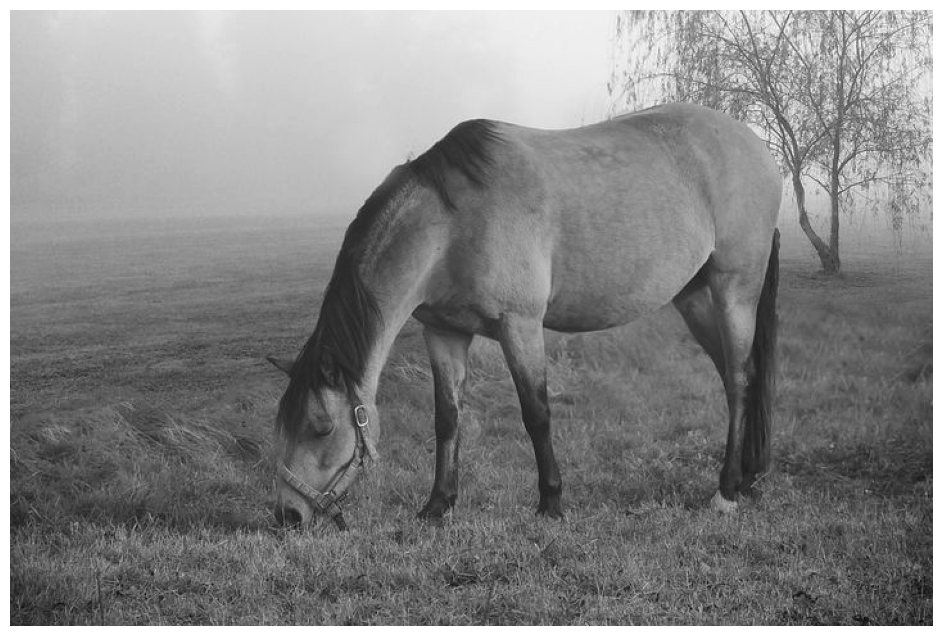

In [4]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến bức ảnh đầu tiên
img_path = "/kaggle/input/data-btl-xla/images/horses.jpg"

# Mở ảnh và chuyển đổi thành ảnh grayscale
img = Image.open(img_path).convert('L')  # Chuyển thành ảnh xám

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(12, 8))

# Hiển thị bức ảnh xám
plt.imshow(img, cmap='gray')  # Đặt `cmap='gray'` để hiển thị ảnh xám

# Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
plt.axis('off')

# Hiển thị ảnh
plt.show()

Ảnh sau xử lý 

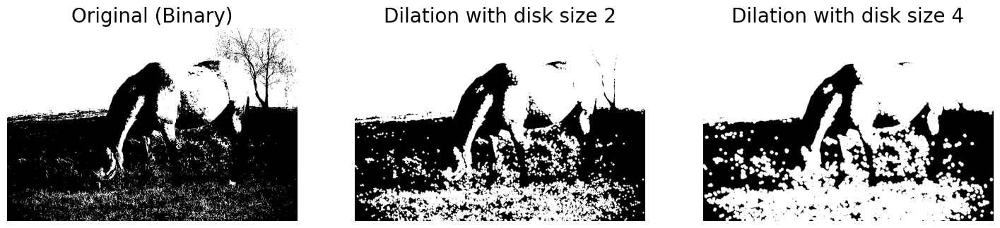

In [5]:
from PIL import Image
import matplotlib.pyplot as plt
from skimage.morphology import binary_dilation, disk
import numpy as np

# Đường dẫn đến bức ảnh đầu tiên
img_path = "/kaggle/input/data-btl-xla/images/horses.jpg"

# Mở ảnh và chuyển đổi thành grayscale, sau đó tạo ảnh nhị phân với ngưỡng 0.5
img = Image.open(img_path).convert('L')
img_np = np.array(img) / 255.0  # Chuyển ảnh thành mảng numpy với giá trị từ 0 đến 1
binary_img = np.where(img_np > 0.5, 1, 0)  # Tạo ảnh nhị phân với ngưỡng 0.5

# Hiển thị ảnh gốc và các ảnh sau khi áp dụng phép giãn với các kích thước khác nhau của đĩa
plt.figure(figsize=(18, 9))
plt.subplot(1, 3, 1)
plt.imshow(binary_img, cmap='gray')
plt.title('Original (Binary)', size=20)
plt.axis('off')

# Thực hiện phép giãn với các kích thước đĩa khác nhau và hiển thị
for d in range(1, 3):
    dilated_img = binary_dilation(binary_img, disk(2 * d))
    plt.subplot(1, 3, d + 1)
    plt.imshow(dilated_img, cmap='gray')
    plt.title(f'Dilation with disk size {2 * d}', size=20)
    plt.axis('off')

plt.show()


# Opening 

Ảnh ban đầu 

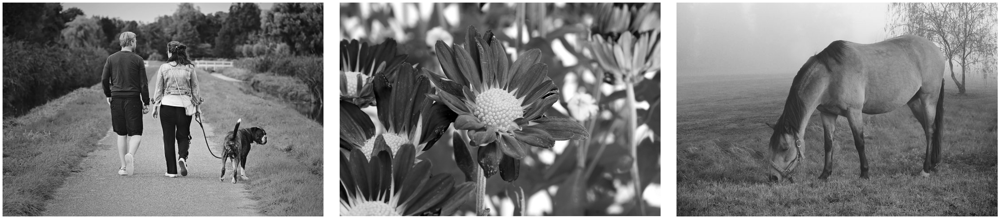

In [6]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến các bức ảnh
img_paths = ["/kaggle/input/data-btl-xla/images/men_dog.jpg",
             "/kaggle/input/data-btl-xla/images/flowers.jpg",
             "/kaggle/input/data-btl-xla/images/horses.jpg"]

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))

# Vòng lặp qua từng ảnh
for i, path in enumerate(img_paths):
    # Mở ảnh và chuyển đổi thành ảnh grayscale
    img = Image.open(path).convert('L')  # Chuyển thành ảnh xám
    
    # Tạo một subplot cho mỗi bức ảnh
    plt.subplot(1, 3, i + 1)
    
    # Hiển thị bức ảnh xám
    plt.imshow(img, cmap='gray')  # Đặt `cmap='gray'` để hiển thị ảnh xám
    
    # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
    plt.axis('off')

# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Hiển thị tất cả các bức ảnh trong cửa sổ
plt.show()

Ảnh sau xử lý

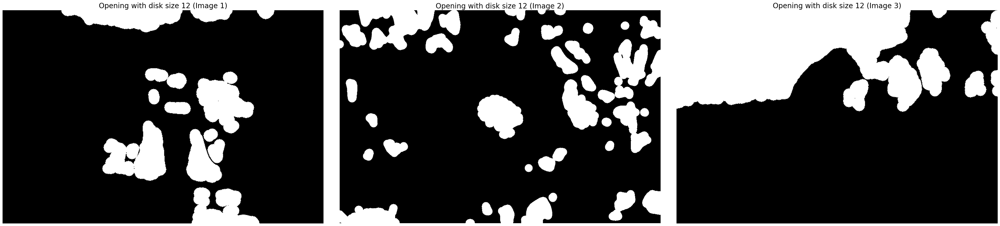

In [7]:
from PIL import Image
import matplotlib.pyplot as plt
from skimage.morphology import binary_opening, disk
from skimage.color import rgb2gray
import numpy as np

# Đường dẫn đến các bức ảnh
img_paths = ["/kaggle/input/data-btl-xla/images/men_dog.jpg",
             "/kaggle/input/data-btl-xla/images/flowers.jpg",
             "/kaggle/input/data-btl-xla/images/horses.jpg"]

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))

# Vòng lặp qua từng ảnh
for i, path in enumerate(img_paths):
    # Mở ảnh, chuyển đổi thành grayscale và chuyển thành ảnh nhị phân
    img = Image.open(path).convert('L')  # Chuyển thành ảnh xám
    img_np = np.array(img) / 255.0       # Chuyển sang mảng numpy và chuẩn hóa
    binary_img = np.where(img_np > 0.5, 1, 0)  # Tạo ảnh nhị phân với ngưỡng 0.5

    # Thực hiện phép toán mở với kích thước đĩa là 12
    opened_img = binary_opening(binary_img, disk(12))
    
    # Hiển thị ảnh sau khi thực hiện phép mở
    plt.subplot(1, 3, i + 1)
    plt.imshow(opened_img, cmap='gray')  # Hiển thị ảnh đã mở
    plt.title(f'Opening with disk size 12 (Image {i+1})', size=20)
    plt.axis('off')

# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Hiển thị tất cả các ảnh trong cửa sổ
plt.show()


# Closing

Ảnh ban đầu 

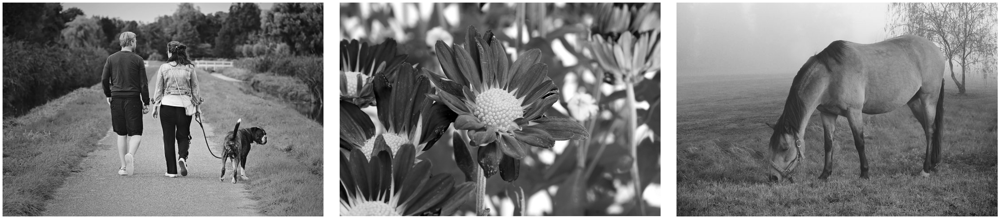

In [8]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến các bức ảnh
img_paths = ["/kaggle/input/data-btl-xla/images/men_dog.jpg",
             "/kaggle/input/data-btl-xla/images/flowers.jpg",
             "/kaggle/input/data-btl-xla/images/horses.jpg"]

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))

# Vòng lặp qua từng ảnh
for i, path in enumerate(img_paths):
    # Mở ảnh và chuyển đổi thành ảnh grayscale
    img = Image.open(path).convert('L')  # Chuyển thành ảnh xám
    
    # Tạo một subplot cho mỗi bức ảnh
    plt.subplot(1, 3, i + 1)
    
    # Hiển thị bức ảnh xám
    plt.imshow(img, cmap='gray')  # Đặt `cmap='gray'` để hiển thị ảnh xám
    
    # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
    plt.axis('off')

# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Hiển thị tất cả các bức ảnh trong cửa sổ
plt.show()

Ảnh sau xử lý 

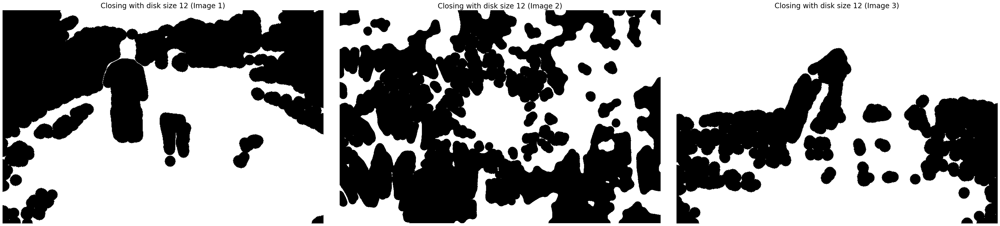

In [9]:
from PIL import Image
import matplotlib.pyplot as plt
from skimage.morphology import binary_closing, disk
import numpy as np

# Đường dẫn đến các bức ảnh
img_paths = ["/kaggle/input/data-btl-xla/images/men_dog.jpg",
             "/kaggle/input/data-btl-xla/images/flowers.jpg",
             "/kaggle/input/data-btl-xla/images/horses.jpg"]

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))

# Vòng lặp qua từng ảnh
for i, path in enumerate(img_paths):
    # Mở ảnh và chuyển đổi thành ảnh grayscale
    img = Image.open(path).convert('L')  # Chuyển thành ảnh xám
    img_np = np.array(img) / 255.0       # Chuyển sang mảng numpy và chuẩn hóa
    binary_img = np.where(img_np > 0.5, 1, 0)  # Tạo ảnh nhị phân với ngưỡng 0.5

    # Thực hiện phép toán đóng với kích thước đĩa là 12
    closed_img = binary_closing(binary_img, disk(12))
    
    # Tạo một subplot cho mỗi bức ảnh sau khi đóng
    plt.subplot(1, 3, i + 1)
    plt.imshow(closed_img, cmap='gray')  # Hiển thị ảnh sau khi thực hiện phép đóng
    plt.title(f'Closing with disk size 12 (Image {i+1})', size=20)
    plt.axis('off')

# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Hiển thị tất cả các ảnh trong cửa sổ
plt.show()


# Skeletonizing

Ảnh ban đầu 

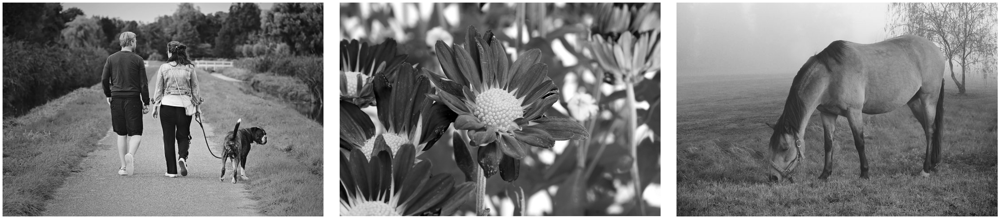

In [10]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến các bức ảnh
img_paths = ["/kaggle/input/data-btl-xla/images/men_dog.jpg",
             "/kaggle/input/data-btl-xla/images/flowers.jpg",
             "/kaggle/input/data-btl-xla/images/horses.jpg"]

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))

# Vòng lặp qua từng ảnh
for i, path in enumerate(img_paths):
    # Mở ảnh và chuyển đổi thành ảnh grayscale
    img = Image.open(path).convert('L')  # Chuyển thành ảnh xám
    
    # Tạo một subplot cho mỗi bức ảnh
    plt.subplot(1, 3, i + 1)
    
    # Hiển thị bức ảnh xám
    plt.imshow(img, cmap='gray')  # Đặt `cmap='gray'` để hiển thị ảnh xám
    
    # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
    plt.axis('off')

# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Hiển thị tất cả các bức ảnh trong cửa sổ
plt.show()

Ảnh sau xử lý 

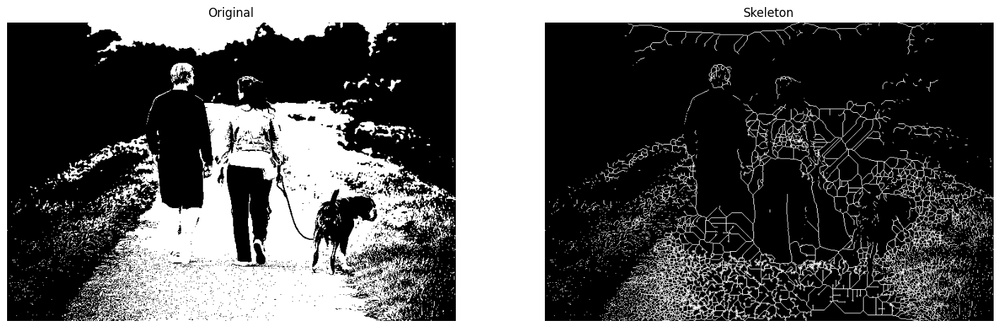

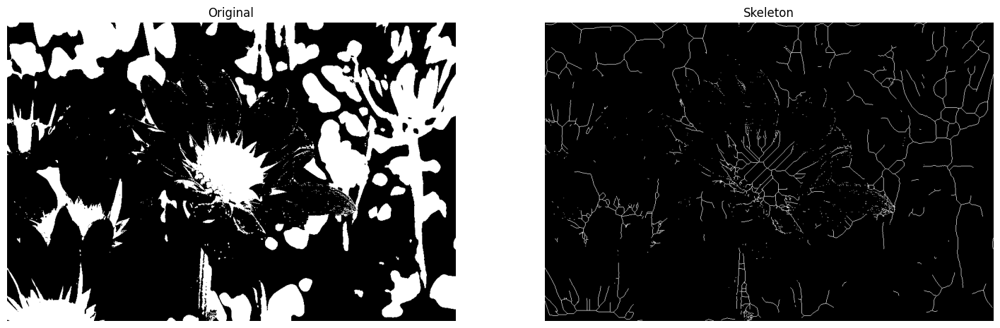

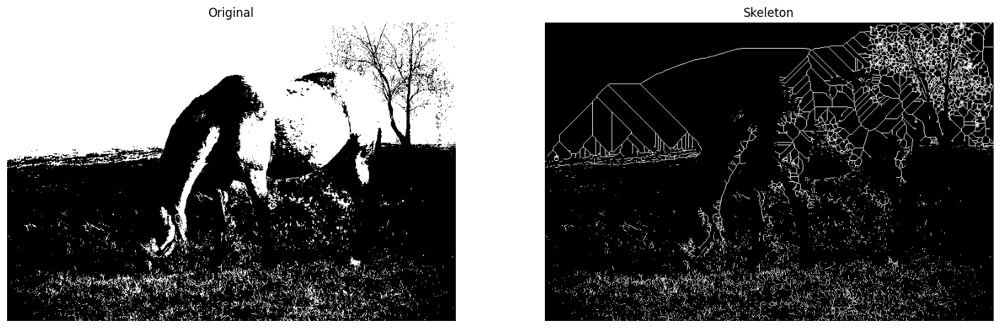

In [11]:
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
from skimage import img_as_float
from skimage.morphology import skeletonize
from skimage.io import imread

# Định nghĩa hàm hiển thị hai ảnh song song
def plot_images_horizontally(original, filtered, filter_name, sz=(18,7)):
    plt.figure(figsize=sz)
    plt.subplot(1, 2, 1)
    plt.imshow(original, cmap='gray')
    plt.title('Original')
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.imshow(filtered, cmap='gray')
    plt.title(filter_name)
    plt.axis('off')
    
    plt.show()

# Đường dẫn đến các bức ảnh
img_paths = ["/kaggle/input/data-btl-xla/images/men_dog.jpg",
             "/kaggle/input/data-btl-xla/images/flowers.jpg",
             "/kaggle/input/data-btl-xla/images/horses.jpg"]

# Vòng lặp qua từng ảnh
for path in img_paths:
    # Mở ảnh và chuyển đổi thành ảnh grayscale
    img = Image.open(path).convert('L')  # Chuyển thành ảnh xám
    img_np = img_as_float(np.array(img))  # Chuyển ảnh sang mảng float để xử lý

    # Tạo ảnh nhị phân với ngưỡng 0.5
    img_binary = np.where(img_np > 0.5, 1, 0)

    # Áp dụng phép skeletonize
    img_skeleton = skeletonize(img_binary)

    # Hiển thị ảnh gốc và ảnh skeleton song song
    plot_images_horizontally(img_binary, img_skeleton, 'Skeleton', sz=(18,9))


# Computing the convex hull

Ảnh ban đầu 

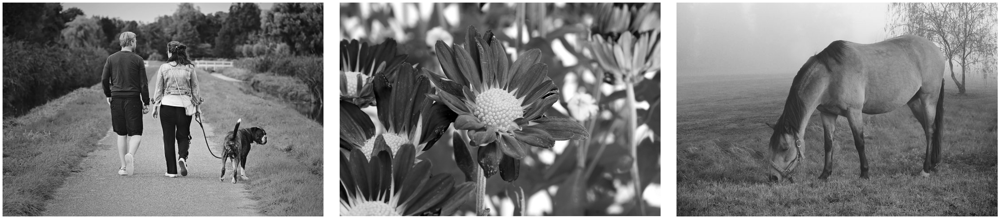

In [12]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến các bức ảnh
img_paths = ["/kaggle/input/data-btl-xla/images/men_dog.jpg",
             "/kaggle/input/data-btl-xla/images/flowers.jpg",
             "/kaggle/input/data-btl-xla/images/horses.jpg"]

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))

# Vòng lặp qua từng ảnh
for i, path in enumerate(img_paths):
    # Mở ảnh và chuyển đổi thành ảnh grayscale
    img = Image.open(path).convert('L')  # Chuyển thành ảnh xám
    
    # Tạo một subplot cho mỗi bức ảnh
    plt.subplot(1, 3, i + 1)
    
    # Hiển thị bức ảnh xám
    plt.imshow(img, cmap='gray')  # Đặt `cmap='gray'` để hiển thị ảnh xám
    
    # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
    plt.axis('off')

# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Hiển thị tất cả các bức ảnh trong cửa sổ
plt.show()

Ảnh sau xử lý 

<Figure size 640x480 with 0 Axes>

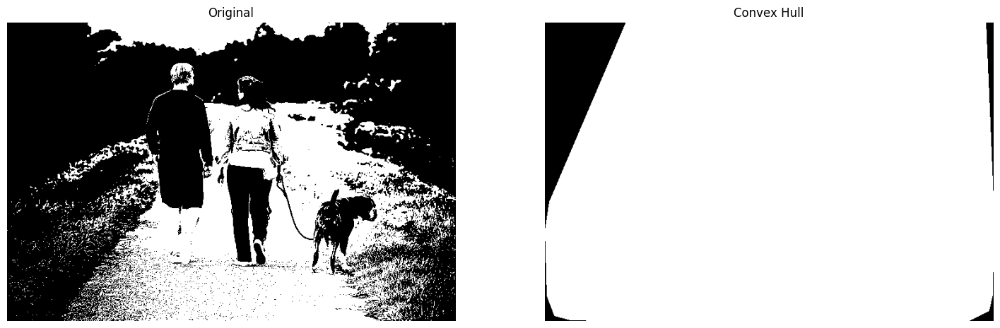

<Figure size 640x480 with 0 Axes>

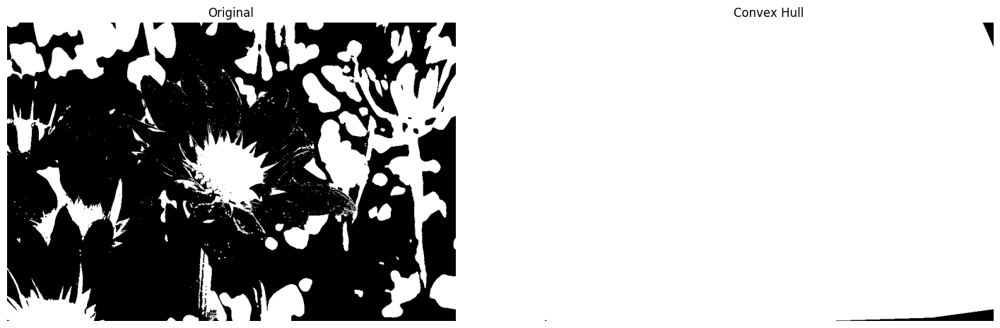

<Figure size 640x480 with 0 Axes>

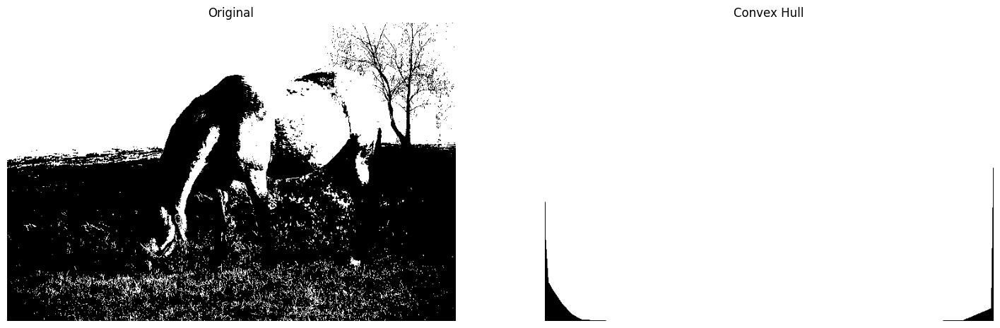

In [13]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from skimage.morphology import convex_hull_image
from skimage.color import rgb2gray
from skimage.io import imread
from skimage.util import img_as_float

# Hàm để hiển thị hai ảnh song song: ảnh gốc và ảnh đã qua xử lý
def plot_images_horizontally(original, filtered, filter_name, sz=(18, 7)):
    plt.gray()
    plt.figure(figsize=sz)
    plt.subplot(1, 2, 1)
    plt.imshow(original, cmap='gray')
    plt.title('Original')
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.imshow(filtered, cmap='gray')
    plt.title(filter_name)
    plt.axis('off')
    
    plt.show()

# Đường dẫn đến các bức ảnh
img_paths = ["/kaggle/input/data-btl-xla/images/men_dog.jpg",
             "/kaggle/input/data-btl-xla/images/flowers.jpg",
             "/kaggle/input/data-btl-xla/images/horses.jpg"]

# Vòng lặp qua từng ảnh
for path in img_paths:
    # Mở ảnh và chuyển thành ảnh xám
    img = Image.open(path).convert('L')
    img_np = np.array(img) / 255.0  # Chuyển thành mảng numpy và chuẩn hóa giá trị

    # Tạo ảnh nhị phân với ngưỡng 0.5 để xử lý convex hull
    binary_img = np.where(img_np > 0.5, 1, 0)
    
    # Áp dụng convex hull
    chull_img = convex_hull_image(binary_img)
    
    # Hiển thị ảnh gốc và ảnh đã qua xử lý
    plot_images_horizontally(binary_img, chull_img, 'Convex Hull', sz=(18, 9))


# White Top-Hat

Ảnh ban đầu 

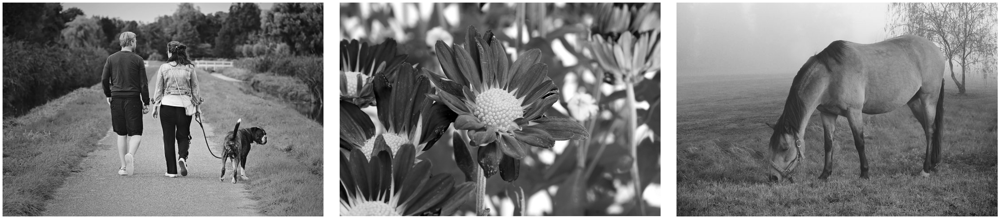

In [14]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến các bức ảnh
img_paths = ["/kaggle/input/data-btl-xla/images/men_dog.jpg",
             "/kaggle/input/data-btl-xla/images/flowers.jpg",
             "/kaggle/input/data-btl-xla/images/horses.jpg"]

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))

# Vòng lặp qua từng ảnh
for i, path in enumerate(img_paths):
    # Mở ảnh và chuyển đổi thành ảnh grayscale
    img = Image.open(path).convert('L')  # Chuyển thành ảnh xám
    
    # Tạo một subplot cho mỗi bức ảnh
    plt.subplot(1, 3, i + 1)
    
    # Hiển thị bức ảnh xám
    plt.imshow(img, cmap='gray')  # Đặt `cmap='gray'` để hiển thị ảnh xám
    
    # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
    plt.axis('off')

# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Hiển thị tất cả các bức ảnh trong cửa sổ
plt.show()

Ảnh sau xử lý 

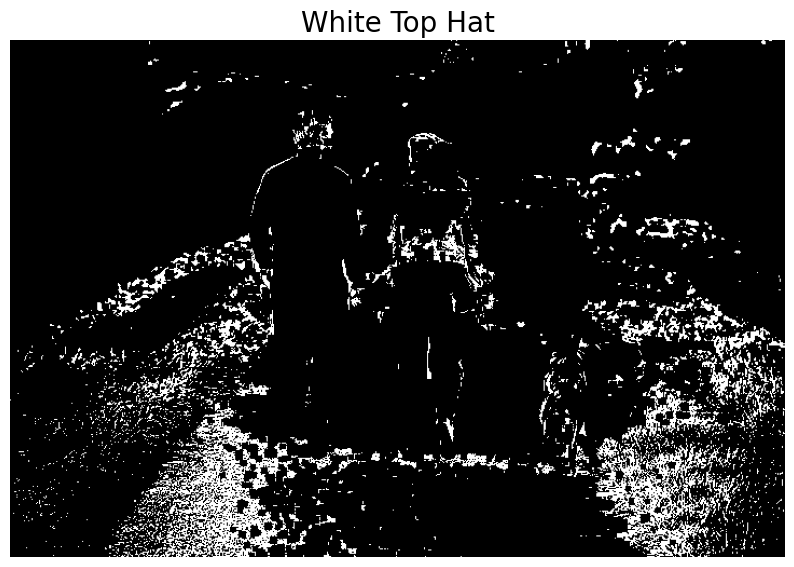

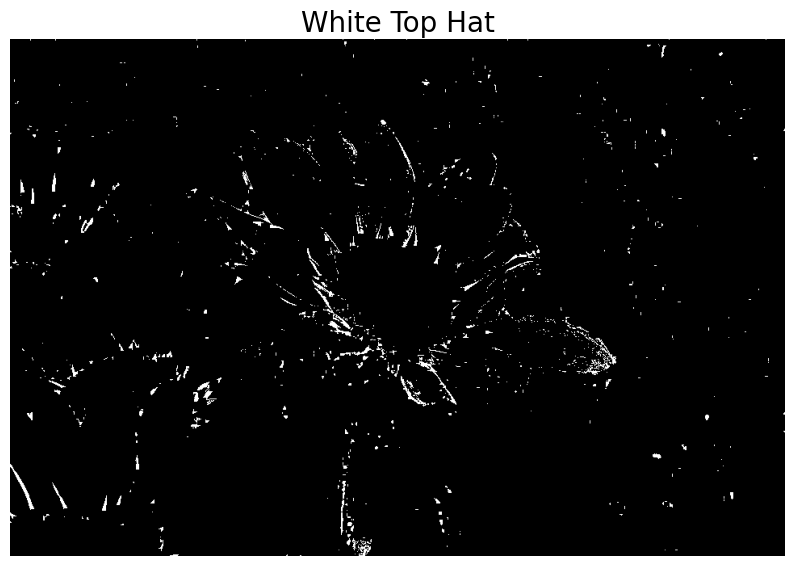

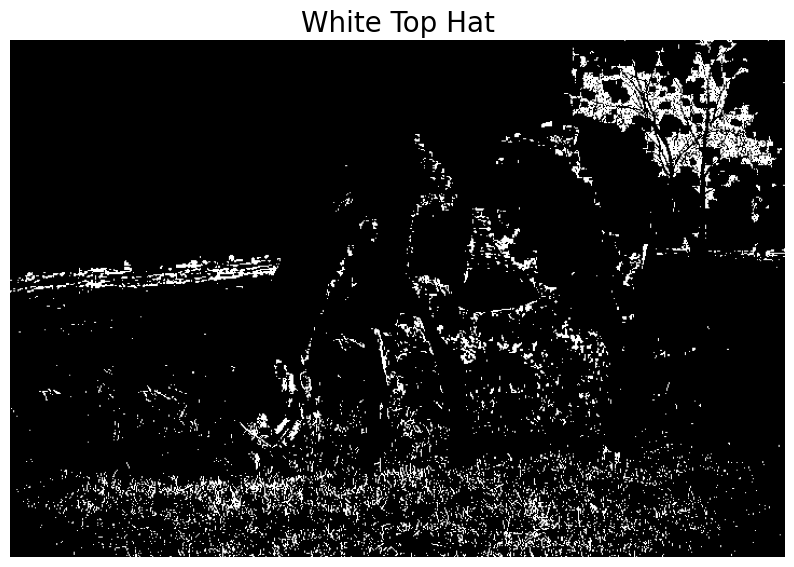

In [15]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from skimage.morphology import white_tophat, square
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.util import img_as_float

# Hàm để hiển thị ảnh
def plot_image(image, title=''):
    plt.title(title, size=20)
    plt.imshow(image, cmap='gray')
    plt.axis('off')  # Tắt trục tọa độ để ảnh nhìn đẹp hơn

# Đường dẫn đến các bức ảnh
img_paths = ["/kaggle/input/data-btl-xla/images/men_dog.jpg",
             "/kaggle/input/data-btl-xla/images/flowers.jpg",
             "/kaggle/input/data-btl-xla/images/horses.jpg"]

# Vòng lặp qua từng ảnh
for path in img_paths:
    # Mở ảnh và chuyển đổi thành ảnh grayscale
    img = Image.open(path).convert('L')
    img_np = np.array(img) / 255.0  # Chuyển thành mảng numpy và chuẩn hóa giá trị

    # Chuyển ảnh thành ảnh nhị phân với ngưỡng 0.5
    binary_img = np.where(img_np > 0.5, 1, 0)

    # Áp dụng phép biến đổi white top hat
    w_tophat = white_tophat(binary_img, square(5))

    # Hiển thị kết quả
    plt.figure(figsize=(10, 10))
    plot_image(w_tophat, 'White Top Hat')
    plt.show()


# Black Top-Hat

Ảnh ban đầu 

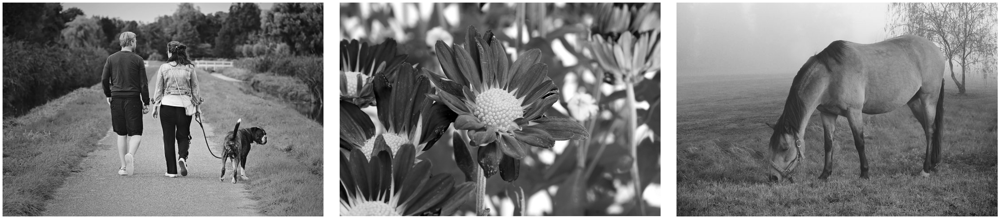

In [16]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến các bức ảnh
img_paths = ["/kaggle/input/data-btl-xla/images/men_dog.jpg",
             "/kaggle/input/data-btl-xla/images/flowers.jpg",
             "/kaggle/input/data-btl-xla/images/horses.jpg"]

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))

# Vòng lặp qua từng ảnh
for i, path in enumerate(img_paths):
    # Mở ảnh và chuyển đổi thành ảnh grayscale
    img = Image.open(path).convert('L')  # Chuyển thành ảnh xám
    
    # Tạo một subplot cho mỗi bức ảnh
    plt.subplot(1, 3, i + 1)
    
    # Hiển thị bức ảnh xám
    plt.imshow(img, cmap='gray')  # Đặt `cmap='gray'` để hiển thị ảnh xám
    
    # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
    plt.axis('off')

# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Hiển thị tất cả các bức ảnh trong cửa sổ
plt.show()

Ảnh sau xử lý 

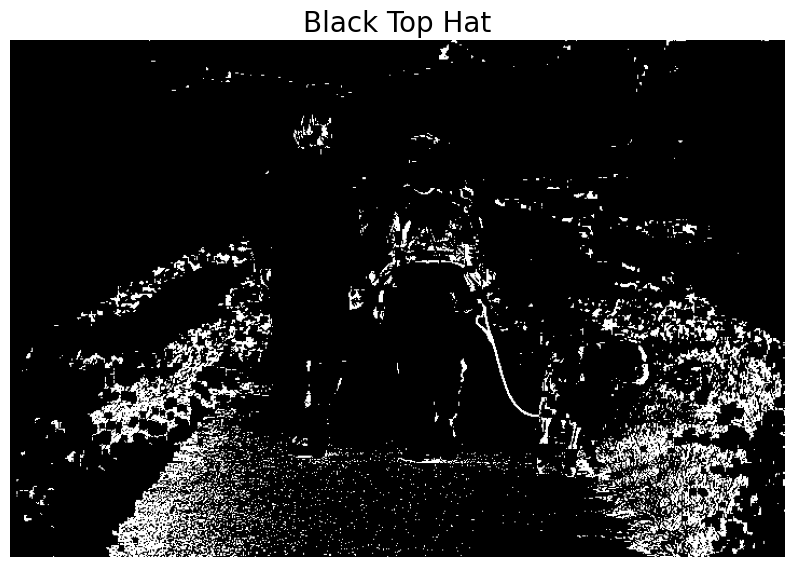

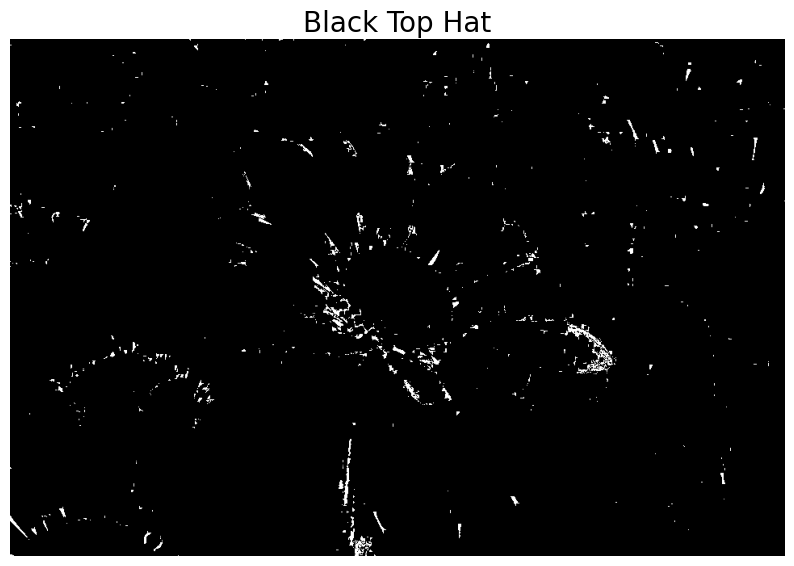

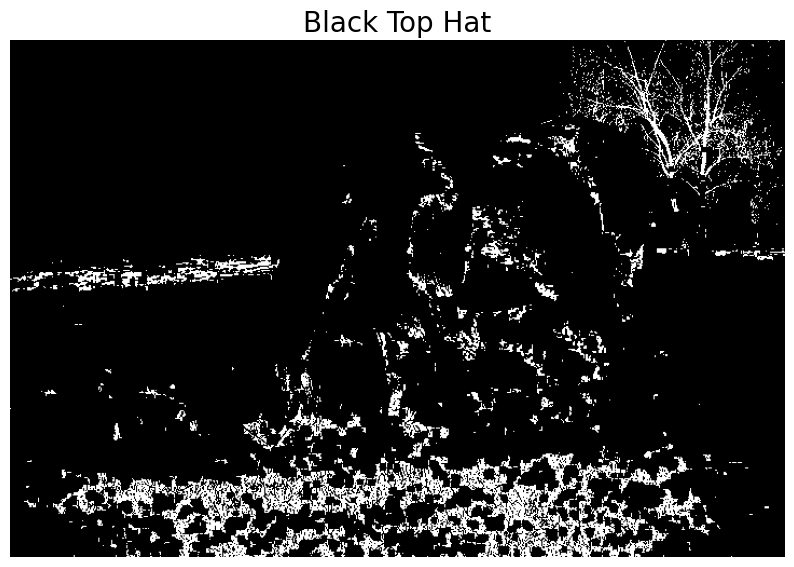

In [17]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from skimage.morphology import black_tophat, square

# Hàm để hiển thị ảnh
def plot_image(image, title=''):
    plt.title(title, size=20)
    plt.imshow(image, cmap='gray')
    plt.axis('off')  # Tắt trục tọa độ để ảnh nhìn đẹp hơn

# Đường dẫn đến các bức ảnh
img_paths = ["/kaggle/input/data-btl-xla/images/men_dog.jpg",
             "/kaggle/input/data-btl-xla/images/flowers.jpg",
             "/kaggle/input/data-btl-xla/images/horses.jpg"]

# Vòng lặp qua từng ảnh
for path in img_paths:
    # Mở ảnh và chuyển đổi thành ảnh grayscale
    img = Image.open(path).convert('L')
    img_np = np.array(img) / 255.0  # Chuyển thành mảng numpy và chuẩn hóa giá trị

    # Chuyển ảnh thành ảnh nhị phân với ngưỡng 0.5
    binary_img = np.where(img_np > 0.5, 1, 0)

    # Áp dụng Black Top Hat
    b_tophat = black_tophat(binary_img, square(5))

    # Hiển thị kết quả
    plt.figure(figsize=(10, 8))
    plot_image(b_tophat, 'Black Top Hat')
    plt.show()


# Extracting the boundary

Ảnh ban đầu 

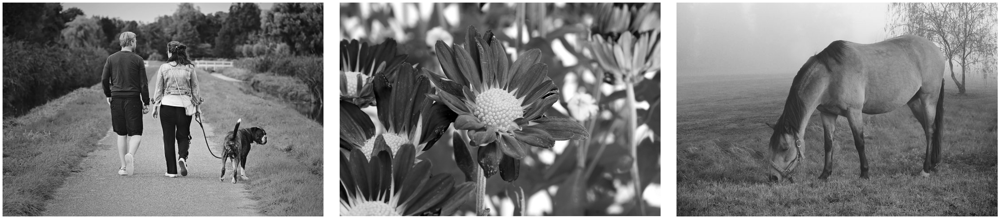

In [18]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến các bức ảnh
img_paths = ["/kaggle/input/data-btl-xla/images/men_dog.jpg",
             "/kaggle/input/data-btl-xla/images/flowers.jpg",
             "/kaggle/input/data-btl-xla/images/horses.jpg"]

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))

# Vòng lặp qua từng ảnh
for i, path in enumerate(img_paths):
    # Mở ảnh và chuyển đổi thành ảnh grayscale
    img = Image.open(path).convert('L')  # Chuyển thành ảnh xám
    
    # Tạo một subplot cho mỗi bức ảnh
    plt.subplot(1, 3, i + 1)
    
    # Hiển thị bức ảnh xám
    plt.imshow(img, cmap='gray')  # Đặt `cmap='gray'` để hiển thị ảnh xám
    
    # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
    plt.axis('off')

# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Hiển thị tất cả các bức ảnh trong cửa sổ
plt.show()

Ảnh sau xử lý 

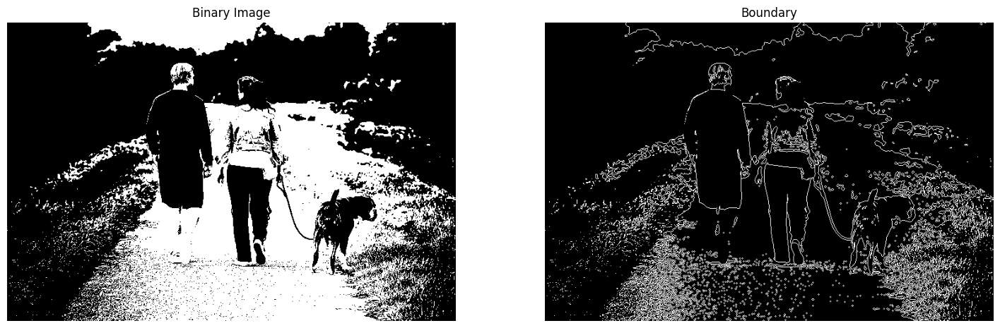

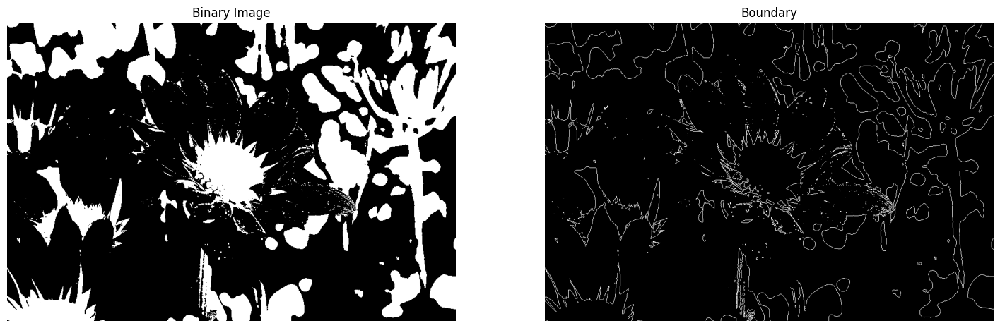

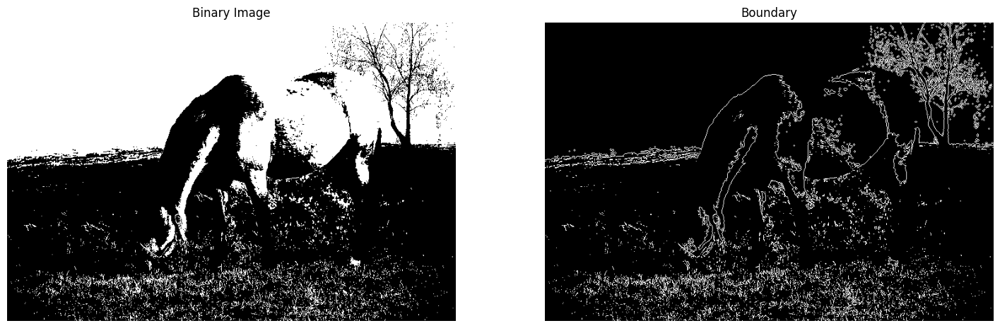

In [19]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from skimage.morphology import binary_erosion
from skimage.color import rgb2gray

# Đường dẫn đến các bức ảnh
img_paths = ["/kaggle/input/data-btl-xla/images/men_dog.jpg",
             "/kaggle/input/data-btl-xla/images/flowers.jpg",
             "/kaggle/input/data-btl-xla/images/horses.jpg"]

# Hàm hiển thị ảnh và boundary cạnh nhau
def plot_images_horizontally(im, boundary, title='', sz=(18, 9)):
    plt.figure(figsize=sz)
    
    # Ảnh gốc sau khi chuyển nhị phân
    plt.subplot(1, 2, 1)
    plt.imshow(im, cmap='gray')
    plt.title("Binary Image")
    plt.axis('off')
    
    # Ảnh boundary
    plt.subplot(1, 2, 2)
    plt.imshow(boundary, cmap='gray')
    plt.title(title)
    plt.axis('off')
    
    plt.show()

# Vòng lặp qua từng ảnh trong danh sách
for path in img_paths:
    # Mở ảnh và chuyển thành grayscale
    img = Image.open(path).convert('L')
    img_np = np.array(img) / 255.0  # Chuyển đổi thành mảng numpy và chuẩn hóa

    # Tạo ảnh nhị phân với ngưỡng (threshold)
    threshold = 0.5
    img_binary = np.where(img_np >= threshold, 1, 0)  # Chuyển thành ảnh nhị phân

    # Tính boundary bằng cách trừ đi ảnh giãn nở nhị phân từ ảnh nhị phân gốc
    boundary = img_binary - binary_erosion(img_binary)

    # Hiển thị ảnh và boundary cạnh nhau
    plot_images_horizontally(img_binary, boundary, title='Boundary', sz=(18, 9))
